| Project #2 | 311 Non-Emergency Services (City of San Diego)  |
| ----------- | ----------- |
| Class | IST 736 - Text Mining |
| Date | 2021 |

In [88]:
import json, string

import folium
import requests
import geocoder
import pandas as pd
import pickle

from folium import Map, Marker, GeoJson, LayerControl, FeatureGroup
from folium.plugins import MarkerCluster
#from ediblepickle import checkpoint

from folium.plugins import MarkerCluster
from folium import FeatureGroup, LayerControl, Map, Marker

In [89]:
from exif import Image
import exifread

In [90]:
# Import 311 request data 
get_it_done = pd.read_csv('get_it_done_2020_ALL.csv') #all 311 requests to date 1/1/2020 -> 12/5/2020

In [91]:
# Filter for locations specs
locations = get_it_done[['lat', 'lng']]
locationlist = locations.values.tolist()

# Removing latitudes and longitudes that are equal to zero with coordinates pointing to "Null Island"
get_it_done =get_it_done[get_it_done['lat'] !=0.0]
get_it_done =get_it_done[get_it_done['lng'] !=0.0]

# Drop NAs so mapping works
get_it_done=get_it_done.dropna(subset=['lng'])
get_it_done=get_it_done.dropna(subset=['lat'])

In [92]:
# Using geocoder to find the locations for the City of San Diego
location = 'San Diego'
loc = geocoder.osm(location)
loc.json

{'accuracy': 0.8727970059518586,
 'address': 'San Diego, San Diego County, California, United States',
 'bbox': {'northeast': [33.114249, -116.9057226],
  'southwest': [32.5347737, -117.3098053]},
 'city': 'San Diego',
 'confidence': 1,
 'country': 'United States',
 'country_code': 'us',
 'county': 'San Diego County',
 'icon': 'https://nominatim.openstreetmap.org/ui/mapicons/poi_boundary_administrative.p.20.png',
 'importance': 0.8727970059518586,
 'lat': 32.7174202,
 'lng': -117.1627728,
 'ok': True,
 'osm_id': 253832,
 'osm_type': 'relation',
 'place_id': 298063901,
 'place_rank': 16,
 'quality': 'administrative',
 'raw': {'place_id': 298063901,
  'licence': 'Data © OpenStreetMap contributors, ODbL 1.0. https://osm.org/copyright',
  'osm_type': 'relation',
  'osm_id': 253832,
  'boundingbox': ['32.5347737', '33.114249', '-117.3098053', '-116.9057226'],
  'lat': '32.7174202',
  'lon': '-117.1627728',
  'display_name': 'San Diego, San Diego County, California, United States',
  'place_

In [93]:
"""TEST"""
#Using a 50 request sample so that the map loads more quickly.
# rndtest = get_it_done.sample(n=50)

"""PROD"""
#Change this back to the entire get_it_done dataset when READY.
#Comment out the rndtest line above
rndtest = get_it_done

In [94]:
# Create horizontal bar chart representing 311 requests by type
service_counts = get_it_done.groupby('service_name')['service_request_id'].count().sort_values(ascending=False).reset_index()
total_sr = service_counts['service_request_id'].sum()
service_counts['percent_total']= service_counts['service_request_id']/total_sr

#service_counts.head()
service_counts.loc[service_counts['percent_total'] >=.01].shape

(20, 3)

Text(0, 0.5, 'Service Request Types')

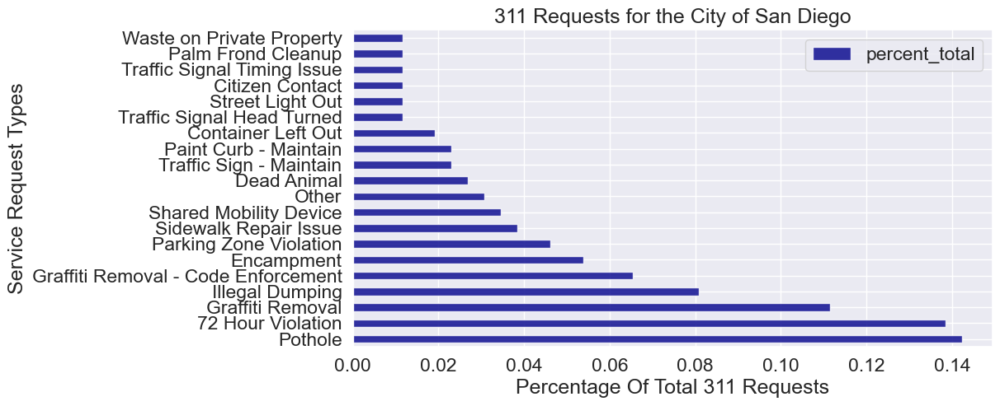

In [95]:
# Plot data
popular_services = service_counts.loc[service_counts['percent_total'] >=.01]
ax = popular_services.plot.barh(x='service_name', y='percent_total', rot=0, color='darkblue', alpha=.8, figsize=(10,5))
ax.set_title('311 Requests for the City of San Diego')
ax.set_xlabel('Percentage Of Total 311 Requests')
ax.set_ylabel('Service Request Types')

| Machine Learning | 311 Service Request Prediction  |
| ----------- | ----------- |

In [96]:
# Machine Learning specific library installation
"""  
IMPORTANT
sklearn is installed with -> pip3 install scikit-learn
"""
from sklearn.feature_extraction.text import CountVectorizer
import pandas as pd
from urllib.request import urlopen # instead of urllib2 like in Python 2.7
import json
import numpy as np
import nltk
import string
import re
from sklearn import naive_bayes
from sklearn.naive_bayes import BernoulliNB
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import MultinomialNB
from sklearn import metrics
from sklearn.metrics import accuracy_score
from nltk.corpus import stopwords
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import roc_auc_score
import numpy as np

#multi-class classification
from sklearn.datasets import make_classification
from sklearn.linear_model import LogisticRegression

from sklearn.datasets import make_classification
from sklearn.linear_model import LogisticRegression
from sklearn.multiclass import OneVsRestClassifier

In [97]:
# IMPORTANT - stopwords
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/mattsutherland/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [98]:
#Loading Get It Done San Diego Data
gid_csv = pd.read_csv('get_it_done_2020_ALL.csv') #static data of all requests in 2020 to date (11/25/20)

In [99]:
""" 
IMPORTANT - This is also an AWESOME fix
-There is an SSL error here.
-Remediation steps below
"""
import nltk
import ssl

try:
    _create_unverified_https_context = ssl._create_unverified_context
except AttributeError:
    pass
else:
    ssl._create_default_https_context = _create_unverified_https_context

nltk.download()


showing info https://raw.githubusercontent.com/nltk/nltk_data/gh-pages/index.xml


True

In [100]:
'''
Multinomial Naive Bayes    
tfidVectorizder
'''
#Filtering data with multiple criteria

gid_cln = gid_csv[(gid_csv['service_name'] == 'Missed Collection') | (gid_csv['service_name'] == 'Illegal Dumping') |
(gid_csv['service_name'] == 'Graffiti Removal') | (gid_csv['service_name'] == 'Encampment') | (gid_csv['service_name'] == '72 Hour Violation') |
(gid_csv['service_name'] == 'Pothole') | (gid_csv['service_name'] == 'Other') | (gid_csv['service_name'] == 'Shared Mobility Device') |
(gid_csv['service_name'] == 'Street Light Out') | (gid_csv['service_name'] == 'Parking Zone Violation') | (gid_csv['service_name'] == 'Sidewalk Repair Issue') |
(gid_csv['service_name'] == 'Traffic Sign - Maintain') | (gid_csv['service_name'] == 'Dead Animal') |
(gid_csv['service_name'] == 'Tree/Limb Fallen/Hanging')]

#Specify Relevant Columns to Keep
keep = ['service_name','public_description']
gid_clnR = gid_cln[keep]
len(gid_clnR)
#203702 requests
#Creating Training and Testing Datasets 70/30
mnb = gid_clnR
print(len(mnb))
#print(len(mnb2))
#58250
mnb_cln = mnb.dropna()
print(mnb_cln)
#print(mnb_cln2)
#[51350 rows x 2 columns]
mnb_cln.head()


stopset = set(stopwords.words('english'))
vectorizer = TfidfVectorizer(use_idf=True, lowercase=True, strip_accents='ascii', stop_words = stopset)

y = mnb_cln.service_name
x = vectorizer.fit_transform(mnb_cln.public_description)
  
print(y.shape)
print(x.shape)
#(51350,)
#(51350, 18314)
#There are 51350 observations and 18314 unique words

#set test train split
x_train, x_test, y_train, y_test = train_test_split(x, y, random_state = 36)

#train naive bayes classifier
clf = naive_bayes.MultinomialNB()
clf.fit(x_train, y_train)

230
               service_name                                 public_description
0    Parking Zone Violation  Large white converted schools bus. People livi...
1    Parking Zone Violation  Tan Chevy RV, parked in dog beach parking lot ...
5    Parking Zone Violation  SHOTS AND FIREWORKS IN BACK OF MY HOUSE AND IT...
6           Illegal Dumping  Illegal dumping of mattress and box spring in ...
9          Graffiti Removal                    PH gang graffiti on street sign
..                      ...                                                ...
290                 Pothole  Large pothole east bound lane Del Mar Heights ...
292                 Pothole  Very large pothole in the middle east bound la...
293  Parking Zone Violation  Has Mexican flag on the window and lots of sti...
296             Dead Animal  Dead skunk has been on side of street (Camino ...
297       72 Hour Violation                             Parked over a week now

[196 rows x 2 columns]
(196,)
(196, 801)


MultinomialNB()

In [101]:
""" 
Request user input to interact with the program
-Using machine learning, the program returns the predicted 311 request type based on text input
"""
#Creating a similar program but now it requests input from the user
request_input = input("What is your non-emergency issue / request? ")
#Test with user originated text
case311_array=np.array([request_input])
case311_vector = vectorizer.transform(case311_array)

print(request_input)
print(clf.predict(case311_vector))

There is a huge hole in the road! I crashed my bike!
['Pothole']


In [102]:
# Location prediction from an image
import os
import PIL.Image
from PIL import Image
import exifread
from PIL.ExifTags import TAGS
from exif import Image

# Parse metadata
from hachoir.parser import createParser
from hachoir.metadata import extractMetadata

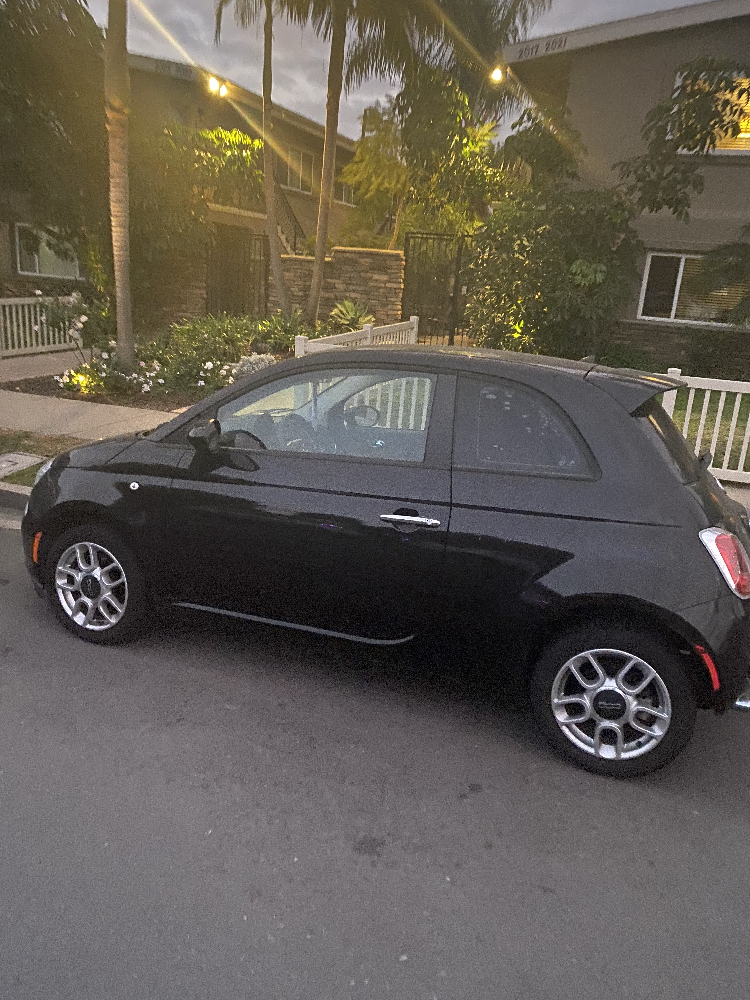

In [103]:
'''View Image'''
fiat = PIL.Image.open('fiat.jpg')
fiat

In [104]:
'''Parse Metadata'''
parser = createParser("fiat.jpg")
#parser = createParser("traffic_light.jpg")
#parser = createParser("t9.png")
metadata = extractMetadata(parser)

for line in metadata.exportPlaintext():
    print(line)

[warn] [/exif/content/ifd[0]] [Autofix] Fix parser error: stop parser, found unparsed segment: start 1800, length 8
[warn] [/exif/content/exif[0]] [Autofix] Fix parser error: stop parser, found unparsed segment: start 5976, length 8, found unparsed segment: start 6040, length 8, found unparsed segment: start 6104, length 8
[warn] [/exif/content] [Autofix] Fix parser error: stop parser, found unparsed segment: start 17672, length 8
[warn] Skip IPTC key 63: 170132
[warn] Skip IPTC key 62: 20201212


Metadata:
- Image width: 3024 pixels
- Image height: 4032 pixels
- Image orientation: Horizontal (normal)
- Bits/pixel: 24
- Pixel format: YCbCr
- Creation date: 2020-12-12 17:01:32
- Latitude: 32.79673888888889
- Longitude: -117.2315
- Altitude: 8.3 meters
- Camera focal: 1.8
- Camera exposure: 1/14
- Camera brightness: -2.47
- City: %G
- Camera model: iPhone 11
- Camera manufacturer: Apple
- Compression: JPEG (Baseline)
- ISO speed rating: 500
- EXIF version: 0231
- Date-time original: 2020-12-12 17:01:32
- Date-time digitized: 2020-12-12 17:01:32
- Shutter speed: 3.77
- Aperture: 1.7
- Exposure bias: 0.0156
- Focal length: 4.25
- Flashpix version: 0100
- Focal length in 35mm film: 26
- Producer: 14.2
- Comment: JPEG quality: 93% (approximate)
- Format version: JFIF 1.01
- MIME type: image/jpeg
- Endianness: Big endian


In [105]:
""" 
Map 311 Requests for the City of San Diego
"""

latlng = [loc.lat, loc.lng]
sd_map = folium.Map(location=latlng,
              #No tiles specification just makes a standard color map like apple maps or google maps
              #tiles = "CartoDB dark_matter",
              #tiles = "stamenwatercolor",
              #tiles = "stamentoner",
              
              zoom_start=15)

mc = MarkerCluster()

fg0_1 = FeatureGroup(name='Less than 1 day old')
fg1_3= FeatureGroup(name='1-3 days old')
fg3_5= FeatureGroup(name='3-5 days old')
fg5_10= FeatureGroup(name='5-10 days old')
fg10_20= FeatureGroup(name='10-20 old')
fg20_= FeatureGroup(name='More than 20 days old')

#age0_10 = rndtest.loc[rndtest['case_age_days'] <=10]
#age10_= rndtest.loc[rndtest['case_age_days'] >10]


for row in rndtest.itertuples():
#    mc.add_child(folium.Marker(location=[row.lat, row.lng],
#                 popup=row.service_name))
    if row.case_age_days <=1:
        Marker(location=[row.lat, row.lng], icon=folium.Icon(color="green"),
      popup= row.service_name).add_to(fg0_1)

    elif row.case_age_days >1 and row.case_age_days <=3:
        Marker(location=[row.lat, row.lng], icon=folium.Icon(color="lightgreen"),
      popup= row.service_name).add_to(fg1_3)
    
    elif row.case_age_days >3 and row.case_age_days <=5:
        Marker(location=[row.lat, row.lng], icon=folium.Icon(color="orange"),
      popup= row.service_name).add_to(fg3_5)
        
    elif row.case_age_days >5 and row.case_age_days <=10:
        Marker(location=[row.lat, row.lng], icon=folium.Icon(color="lightred"),
       popup= row.service_name).add_to(fg5_10)
    
    elif row.case_age_days >10 and row.case_age_days <=20:
        Marker(location=[row.lat, row.lng], icon=folium.Icon(color="red"),
       popup= row.service_name).add_to(fg10_20)
        
    else:
        Marker(location=[row.lat, row.lng], icon=folium.Icon(color="darkred"),
       popup= row.service_name).add_to(fg20_)
        

fg0_1.add_to(sd_map)
fg1_3.add_to(sd_map)
fg3_5.add_to(sd_map)
fg5_10.add_to(sd_map)
fg10_20.add_to(sd_map)
fg20_.add_to(sd_map)
LayerControl().add_to(sd_map)

#Add children to map    
#sd_map.add_child(mc)
sd_map   


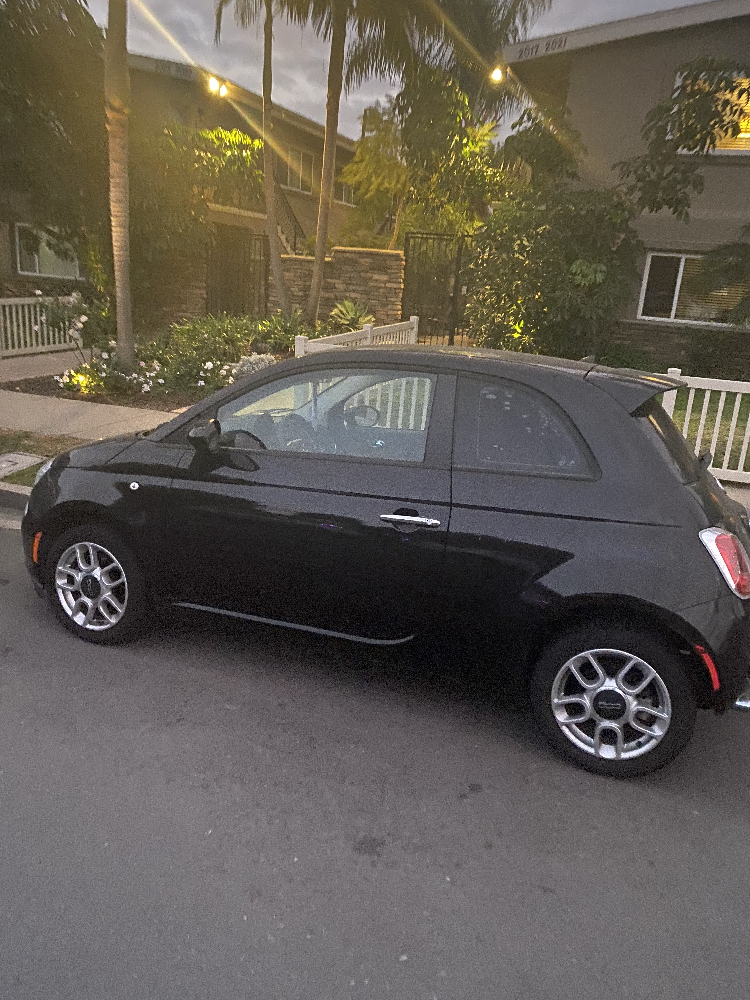

In [106]:
# Plot location on dark map
car_map = folium.Map(location=latlng,
              #No tiles specification just makes a standard color map like apple maps or google maps
              tiles = "CartoDB dark_matter",
              #tiles = "stamenwatercolor",
              #tiles = "stamentoner",
              zoom_start=13)

feature_group = FeatureGroup(name='Fiat 500')

fiat_icon = folium.features.CustomIcon('fiat.jpg', icon_size=(50,50))
fiat_popup="<strong>Location:</strong><br>Fiat 500"
Marker(location=[32.79673888888889,-117.2315], icon=fiat_icon, tooltip="Fiat 500",
    popup=fiat_popup).add_to(car_map)

car_map   

| END OF PROGRAM |
| ----------- |